
# Mini Project 1

## Geometric manipulations in Geopandas, projections, creating maps

**Name:** Parker Addison


In [13]:
%matplotlib inline 
import geopandas as gpd
import pandas as pd
import shapely
from shapely.geometry import Point
import folium
import numpy as np
import matplotlib
from sklearn.preprocessing import OrdinalEncoder

We want to find large parks that are nearby.  Write a function which generates a GeoDataFrame with the N nearest polygons to a given lat/long value that are larger than a given area.  Then, write a function to show these nearby parks on a map, as well as the lat/long value and distance buffers.  For extra credit, write a similar function to display an interactive folium map with the same information.

Note the following considerations:
* An arbitrarily selected point may be within a park (even on a park boundary - though that is not too likely), but this park may not satisfy the size criteria
* Be careful about projections used for different data frames, and distance units. Geometric operations would only make sense if the different data frames are in the same projection, and the distance units are those recognized by the projection. You will have to convert between miles, feet, sqmiles, acres, etc. Note that San Diego data are in California State Plane Zone 6 - see http://spatialreference.org/ref/epsg/nad83-california-zone-6-ftus/. It is epsg:2230 (really, you should figure this out using geopandas.)
* the map should contain several common map elements
* add comments to each step in your code
* try to see if you can make it run faster (for extra credit)


Questions for extra credit:
1. Looking back, where can you make this process run faster? Think about the choices you made, especially with respect to expensive operations.
2. Create the same map in Folium

---

### Part I: `nearby_parks`

Setup for the first function:

```python
def nearby_parks(poi_lat, poi_lon, poly_gdf, area_col, area_col_unit, min_area_sqmiles, num_parks):
    return gdf_of_selected_polys_closestN, point_gdf
```
* poi_lat and poi_lon are coordinates of the arbitrary point of interest.
* poly_gdf: geopandas geodataframe, which you instantiated with the San Diego parks data from SanDAG (feel free to  use the copy we already downloaded and use in the lecture, or download from sandag.org)
* area_col: the column in the dataframe that you will use to select polygons based on their size (in our case, this field is 'GIS_ACRES')  
* area_col_unit: the unit of the area column above
* min_area_sqmiles: the minimal size of the park polygons we are interested in, in square miles. Let's say, we are interested in parks which are 0.5 sq miles of larger
* num_parks: the number of the closest parks to return. Let's say we are interested in 3 parks. 

To be returned:
* geopandas gdf for the N selected parks
* geopandas gdf for the point of interest (we need that to enter in the next function.)

In [3]:
### YOUR CODE HERE ###

lat = 32.8818006
lon = -117.2357122
sd_parks = gpd.read_file("../../../../../../dsc170sp19-public/sandiego/parks/PARKS.shp")
area_col = "GIS_ACRES" # Could also be "Shape_STAr"
area_col_unit = "acre" # Could also be "sqfeet"
min_sqmiles = 0.5
num_parks = 3

def nearby_parks(poi_lat, poi_lon, poly_gdf, area_col, area_col_unit, min_area_sqmiles, num_parks):
    
    # First let's start by converting area in acres to area in square miles.
    # This will allow us to filter by minimum area first.
    
    # Note: The Shape_STAr provides us with area in square feet, and is the same as 
    # calling df.geometry.area
    
    # One acre to n square miles
    acres_to_sqmiles = 0.001562501
    # One square foot to n square miles
    sqfeet_to_sqmiles = 1 / 5280**2
    
    conversions = {
        "acre": acres_to_sqmiles,
        "sqfeet": sqfeet_to_sqmiles
    }
    
    sqmile_areas = poly_gdf[area_col] * conversions[area_col_unit]
    
    # Looking only at parks that meet the minimum size requirement.
    df_eligible_size = poly_gdf.loc[sqmile_areas >= min_area_sqmiles, :]

    
    # It is good practice to define the crs, since we're going to compare this dataframe with
    # another Point soon.
    df_eligible_size.crs = {"init": "epsg:2230"}

    
    # Before we can compare, we must create a Shapely point.  Note that the polygons currently
    # represented in the projection epsg=2230.
    #
    # Since we have lat-long coordinates, let's convert our Point to epsg=2230.
    # Reference: http://geopandas.org/projections.html
    #
    # This is a very expensive operation, so it's good that we choose to convert only this
    # point, as opposed to converting all Polygons.

    
    # Note that our points should be represented as (LONG, LAT)
    poi_gdf = (
        gpd.GeoDataFrame(
            {"NAME": "Point of Interest", "geometry": [Point(poi_lon, poi_lat)]},
            crs={"init": "epsg:4326"}
        )
        .to_crs(epsg=2230)
    )
    
    
    # Now we can use Shapely to get the distances.
    #
    # It's time to make an executive decision: 
    # **What do we consider to be the distance between a Polygon and a point?**
    #
    # We should probably consider the *minimum* distance to a boundary of the polygon.
    # This would make sense on a human level, as we're interested in getting *into* a large
    # and nearby park, we're not too concerned about getting all the way to the center of
    # the park.
    #
    # Note that Shapely takes care of this calculation in their .distance method.
    #
    # Note that this operation is likely fiarly expensive, so it's good that we filtered
    # first by area (an inexpensive operation).
    #
    # Note that these distances are euclidian distances in feet.  This is another good
    # reason that we converted our Point to epsg 2230, because a distance in feet is easily
    # interpretable, whereas an L2 distance in lon-lat is going to be pretty hard to
    # understand on a digestible level!
    distances = df_eligible_size.geometry.distance(poi_gdf.geometry[0])
    
    
    # Now that we have distances, we can just choose the N parks (already filtered to be
    # of elligible size) with the minimum distance to our Point.
    selected_parks = poly_gdf.loc[distances.sort_values()[:num_parks].index, :]

    
    return selected_parks, poi_gdf

---

```
Testing output of nearby_parks using all given input values.
```

In [4]:
out = nearby_parks(lat, lon, sd_parks, area_col, area_col_unit, min_sqmiles, num_parks)

In [5]:
out[0]

,NAME,OWNERSHIP,GIS_ACRES,PARK_TYPE,SOURCE,SOURCE_DAT,SOURCE_NOT,LOCATION,ALIAS_NAME,SOURCE_ID,Shape_STAr,Shape_STLe,geometry
438,TORREY PINES CITY PARK,City of San Diego,464.189671,Regional,City of San Diego,0516,Regional Park,"12001 TORREY PINES PARK RD, 92037",Torrey Pines City Park,None,2.022004e+07,44242.586584,"POLYGON ((6256325.000021726 1912700.000043631,..."
21,Torrey Pines SNR,State Parks,1466.797307,State,State Parks,0416,None,None,Torrey Pines State Nature Reserve,630,6.389337e+07,92614.258118,(POLYGON ((6251654.370911568 1923200.121103719...
823,LOS PENASQUITOS CANYON OS,City of San Diego,321.546957,Open Space,City of San Diego,0516,Open Space,None,Los Penasquitos Canyon Open Space,None,1.400654e+07,20047.610800,"POLYGON ((6268868.038911983 1913811.8390273, 6..."


In [6]:
out[1]

,NAME,geometry
0,Point of Interest,POINT (6259053.27963547 1902049.043278969)


```
Testing different input for area_col, area_col_unit, and num_parks.
```

In [7]:
nearby_parks(lat, lon, sd_parks, "Shape_STAr", "sqfeet", min_sqmiles, 5)[0]

,NAME,OWNERSHIP,GIS_ACRES,PARK_TYPE,SOURCE,SOURCE_DAT,SOURCE_NOT,LOCATION,ALIAS_NAME,SOURCE_ID,Shape_STAr,Shape_STLe,geometry
438,TORREY PINES CITY PARK,City of San Diego,464.189671,Regional,City of San Diego,0516,Regional Park,"12001 TORREY PINES PARK RD, 92037",Torrey Pines City Park,None,2.022004e+07,44242.586584,"POLYGON ((6256325.000021726 1912700.000043631,..."
21,Torrey Pines SNR,State Parks,1466.797307,State,State Parks,0416,None,None,Torrey Pines State Nature Reserve,630,6.389337e+07,92614.258118,(POLYGON ((6251654.370911568 1923200.121103719...
823,LOS PENASQUITOS CANYON OS,City of San Diego,321.546957,Open Space,City of San Diego,0516,Open Space,None,Los Penasquitos Canyon Open Space,None,1.400654e+07,20047.610800,"POLYGON ((6268868.038911983 1913811.8390273, 6..."
513,MISSION BAY PARK,City of San Diego,4108.393518,Regional,City of San Diego,0516,Regional Park,"2682 INGRAHAM ST, 92109",Mission Bay Park,None,1.789611e+08,124527.654955,(POLYGON ((6265661.000378564 1871727.023262709...
2244,FAIRBANKS RANCH COUNTRY CLUB,City of San Diego,372.739097,Open Space,City of San Diego,0516,Open Space,None,Fairbanks Ranch Country Club,None,1.623646e+07,24373.746879,"POLYGON ((6271249.060068563 1939481.297858879,..."


```
Testing different inputs for min_sqmiles.
```

In [8]:
nearby_parks(lat, lon, sd_parks, area_col, area_col_unit, 0, 3)[0]

,NAME,OWNERSHIP,GIS_ACRES,PARK_TYPE,SOURCE,SOURCE_DAT,SOURCE_NOT,LOCATION,ALIAS_NAME,SOURCE_ID,Shape_STAr,Shape_STLe,geometry
2495,LA JOLLA OS,City of San Diego,16.508722,Open Space,City of San Diego,0516,Open Space,None,La Jolla Os,None,719117.681641,7220.714099,"(POLYGON ((6261433.825105891 1905217.86704205,..."
1941,LA JOLLA OS,City of San Diego,1.875915,Open Space,City of San Diego,0516,Open Space,None,La Jolla Open Space,None,81714.597656,3682.072322,(POLYGON ((6256493.943909571 1898423.997099623...
2235,CLEAR. SITE 675,City of San Diego,0.271354,Open Space,City of San Diego,0516,Open Space,None,Clear. Site 675,None,11820.166016,539.888856,"POLYGON ((6257752.195001975 1898174.037953883,..."


In [9]:
nearby_parks(lat, lon, sd_parks, area_col, area_col_unit, 100, 5)[0]

,NAME,OWNERSHIP,GIS_ACRES,PARK_TYPE,SOURCE,SOURCE_DAT,SOURCE_NOT,LOCATION,ALIAS_NAME,SOURCE_ID,Shape_STAr,Shape_STLe,geometry
60,Anza-Borrego Desert SP,State Parks,622526.147245,State,State Parks,0416,None,None,Anza-Borrego Desert State Park,622,2.711715e+10,3.990187e+06,(POLYGON ((6453456.463041484 2115161.008506626...
12,Anza-Borrego Desert SW,State Parks,321407.822495,State,State Parks,0416,None,None,Anza-Borrego Desert State Wilderness,624,1.400048e+10,2.970729e+06,"(POLYGON ((6578467.064725816 1819190.39703697,..."
9,Santa Rosa Mountains SW,State Parks,136643.958677,State,State Parks,0416,None,None,Santa Rosa Mountains State Wilderness,627,5.952192e+09,7.532530e+05,"(POLYGON ((6511346.715370983 2076645.00811097,..."


---

### Part II: `show_map`

Setup for the second function:   

```python
def show_map (poly_gdf, choro_col, prop_col, num_props, poi_gdf, buffers, title):
    return map_object
```

The inputs are:
* poly_gdf: same as above
* poi_gdf: as returned from the function above.
* choro_col: a column in the polygon geodataframe with values that we will use to show as a choropleth map layer. In our case, let's use 'PARK_TYPE' to show classes of parks with different colors.
* prop_col: a column in the polygon geodataframe with values that we will use to show as a proportional symbol layer rendered over the choropleth layer. Let's use 'GIS_ACRES' so that proportional symbols reflect the size of the parks. 
* num_props: we will use proportional symbols to show not all parks but N largest parks, this is the number of the parks to show.
* buffers: a list of buffer distances from our point of interest that we'll also show on the map. For example, use buffers = [10,20,30], which would mean that the map should include concentric circles with radii of 10 miles, 20 miles, 30 miles, centered on the point of interest.
* title: the title to show above the map.

The output map object should have at least the following layers (in the order of drawing):
* parks, with colors showing park types (include a legend)
* representative points for the first N largest parks, with size of circles proportional to the park size
* distance buffers of different size centered on the initial point of interest. Use different transparency values to show the distance buffers. 
* The point of interest itself.

In [10]:
### YOUR CODE HERE ###

def show_map(poly_gdf, choro_col, prop_col, num_props, poi_gdf, buffers, title):
    
    # Creating a color coded map is a simple as plotting our parks and specifying a column!
    map_object = poly_gdf.plot(column=choro_col, legend=True, figsize=(20, 20))
    
    # We can find the n largest parks, which we will then create proportional symbols on.
    #
    # To put the symbols in a place that makes sense, let's use `representative_point`, since
    # a centroid may be in a strange location since some parks are irregularly shaped.  We
    # want the point to for-sure be inside of the park in order to be interpretable.
    n_largest = poly_gdf.sort_values(prop_col, ascending=False).iloc[:5]
    n_largest = n_largest.assign(geometry=n_largest.geometry.representative_point())
    
    # Marker size units are relative to the figure.
    marker_max_size = map_object.figure.get_size_inches()[0] * map_object.figure.dpi * 2
    
    # Now we can just plot the points we find and scale accordingly.
    n_largest.plot(
        ax=map_object,
        markersize=n_largest.prop_col / n_largest.prop_col.max() * marker_max_size,
        marker='o', c='g')

    # Our geometry units are in feet, so we need to convert e.g. 10, 20, 30 miles to feet
    feet_to_miles = 5280
    buffer_feet = map(lambda x: x * feet_to_miles, buffers)
    buffer_df = gpd.GeoDataFrame(
        {
            "geometry": list(map(lambda radius: poi_gdf.geometry.item().buffer(radius), buffer_feet)),
        }
    )
    buffer_df.plot(ax=map_object, color='k', alpha=0.05)

    poi_gdf.plot(ax=map_object, markersize=100, marker='o', c='k')
    
    map_object.set_title(title)
    
    return map_object

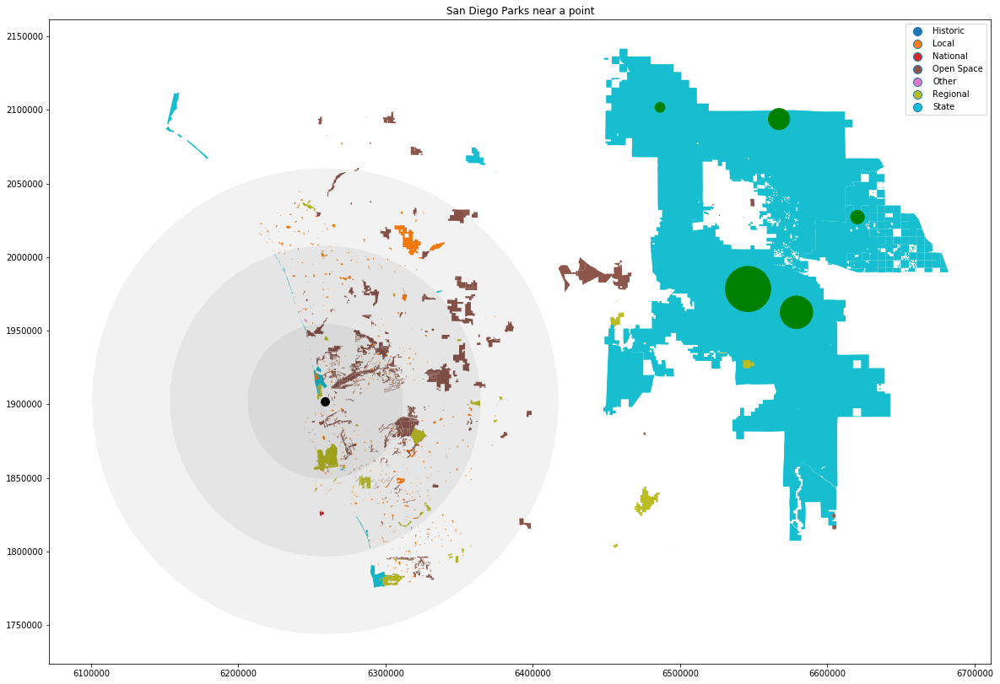

In [11]:
lat = 32.8818051
lon = -117.2357122
min_sqmiles = 0.5
area_col = "GIS_ACRES"
area_col_unit= "acre"
sd_parks = gpd.read_file("../../../../../../dsc170sp19-public/sandiego/parks/PARKS.shp")
num_parks = 3

selected_parks, poi_gdf = nearby_parks(lat, lon, sd_parks, area_col, area_col_unit, min_sqmiles, num)

choro_col = "PARK_TYPE"
prop_col = "GIS_ACRES"
num_props = 100
buffers = [10,20,30]
title = "San Diego Parks near a point"
map_out = show_map(sd_parks, choro_col, prop_col, num_props, poi_gdf, buffers, title)
map_out

---

### Extra credit:

Questions for extra credit:
1. Looking back, where can you make this process run faster? Think about the choices you made, especially with respect to expensive operations.
2. Create the same map in Folium

### Responses to the extra credit questions:

1. Initially I converted all Park Polygons to epsg 4326 so that I could calculate the distance between the Parks and the Point of Interest.  This was a very expensive decision, since every Park consisted of one or more Polygons which consisted of many coordinates which all had to be converted!  So, I rewrote my function to convert the POI into epsg 2230 instead of the other way around.  This saved multiple minutes worth of compute time.

    Additionally, I decided to filter out all Parks that didn't meet the minimum area requirement before calculating the distances to the POI.  This is because the conversion of the areas is extremely cheap, whereas the distance calculates are more expensive, so I wanted to reduce the number of calculations required.


2. See Folium below

In [14]:
sd_parks.crs = {"init": "epsg:2230"}
sd_4326 = sd_parks.to_crs(epsg=4326)

In [15]:
sd_4326.head()

,NAME,OWNERSHIP,GIS_ACRES,PARK_TYPE,SOURCE,SOURCE_DAT,SOURCE_NOT,LOCATION,ALIAS_NAME,SOURCE_ID,Shape_STAr,Shape_STLe,geometry
0,South Carlsbad SB,State Parks,115.895776,State,State Parks,0416,None,None,South Carlsbad State Beach,652,5.048404e+06,46294.948338,(POLYGON ((-117.3289181519653 33.1234542779499...
1,Torrey Pines SB,State Parks,67.294250,State,State Parks,0416,None,None,Torrey Pines State Beach,631,2.931328e+06,47389.938931,POLYGON ((-117.2614792039472 32.93883740843791...
2,Ruocco Park,SDUPD,3.312523,Local,SDUPD,0416,None,"585 Harbor Ln, San Diego. California",Ruocco Park,None,1.443292e+05,1697.299067,POLYGON ((-117.1713009587912 32.71138601435949...
3,Tuna Harbor Park,SDUPD,0.639034,Local,SDUPD,0416,None,"700 North Harbor Dr, San Diego. California",Tuna Harbor Park,None,2.782979e+04,981.199832,"POLYGON ((-117.1727364269394 32.7117167625649,..."
4,San Diego Bayfront Park,SDUPD,3.669269,Local,SDUPD,0416,None,"One Park Boulevard, San Diego. California",San Diego Bayfront Park,None,1.598233e+05,2252.806550,(POLYGON ((-117.1604490837754 32.7043860364382...


In [26]:
# For style rendering.
def rgb_to_hex(rgb):
    rgb_255 = tuple(map(lambda x: int(x * 255), rgb))
    return "#%02x%02x%02x" % rgb_255[:3]

# For style rendering.
def style(feature):
    color = matplotlib.cm.Set1

    encoding = int(feature["properties"]["ordinal"])                   
    fill_color = rgb_to_hex(color(encoding))
    
    return {
        "fillColor": fill_color,
        "fillOpacity": 1,
        "weight": 0
    }
   
### Creating color coded map
#
# Helper function.
def create_folium_map(sd):
    """
    Instantiates a folium map and adds a color coded parks layer.
    """
    m = folium.Map(location=(lat,lon), zoom_start=9, tiles="cartodbpositron")
    
    folium.GeoJson(
        data=sd,
        style_function=style
    ).add_to(m)

    return m


### Adding legend
#
# Helper function.
def add_legend(m, sd):
    """
    Adds the corresponding legend to the map.
    """
    
    color = matplotlib.cm.Set1

    colors = list(map(rgb_to_hex, map(color, sd.ordinal.unique().astype(int))))
    types = sd.PARK_TYPE.unique()

    np.ravel([colors, types])

    #! CREDIT WHERE CREDIT IS DUE
    #
    #  Source: https://nbviewer.jupyter.org/gist/talbertc-usgs/18f8901fc98f109f2b71156cf3ac81cd
    #  This Python, HTML, and CSS code was copied directly from the source.  The only changes I
    #  made were in adding the Python string formatting to add all legend colors and labels.
    from branca.element import Template, MacroElement

    template = """
    {{% macro html(this, kwargs) %}}

    <!doctype html>
    <html lang="en">
    <head>
      <meta charset="utf-8">
      <meta name="viewport" content="width=device-width, initial-scale=1">
      <title>jQuery UI Draggable - Default functionality</title>
      <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

      <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
      <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>

      <script>
      $( function() {{
        $( "#maplegend" )
    }});

      </script>
    </head>
    <body>


    <div id='maplegend' class='maplegend' 
        style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
         border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>

    <div class='legend-title'>Legend</div>
    <div class='legend-scale'>
      <ul class='legend-labels'>
        <li><span style='background:{0};'></span>{7}</li>
        <li><span style='background:{1};'></span>{8}</li>
        <li><span style='background:{2};'></span>{9}</li>
        <li><span style='background:{3};'></span>{10}</li>
        <li><span style='background:{4};'></span>{11}</li>
        <li><span style='background:{5};'></span>{12}</li>
        <li><span style='background:{6};'></span>{13}</li>

      </ul>
    </div>
    </div>

    </body>
    </html>

    <style type='text/css'>
      .maplegend .legend-title {{
        text-align: left;
        margin-bottom: 5px;
        font-weight: bold;
        font-size: 90%;
        }}
      .maplegend .legend-scale ul {{
        margin: 0;
        margin-bottom: 5px;
        padding: 0;
        float: left;
        list-style: none;
        }}
      .maplegend .legend-scale ul li {{
        font-size: 80%;
        list-style: none;
        margin-left: 0;
        line-height: 18px;
        margin-bottom: 2px;
        }}
      .maplegend ul.legend-labels li span {{
        display: block;
        float: left;
        height: 16px;
        width: 30px;
        margin-right: 5px;
        margin-left: 0;
        border: 1px solid #999;
        }}
      .maplegend .legend-source {{
        font-size: 80%;
        color: #777;
        clear: both;
        }}
      .maplegend a {{
        color: #777;
        }}
    </style>
    {{% endmacro %}}""".format(*np.ravel([colors, types]))

    macro = MacroElement()
    macro._template = Template(template)

    m.get_root().add_child(macro)

In [90]:
### YOUR CODE HERE

import folium

lat = 32.8818051
lon = -117.2357122

def show_map_folium(poly_gdf, choro_col, prop_col, num_props, poi_gdf, buffers, title): 

    if poly_gdf.crs["init"] != "epsg:4326":
        print("Converting projection... may take a while.")
        sd_4326 = poly_gdf.to_crs(epsg=4326)
    else:
        sd_4326 = poly_gdf
        
    if poi_gdf.crs["init"] != "epsg:4326":
        poi_gdf = poi_gdf.to_crs(epsg=4326)
    
    # NOTE: The park types must be encoded as integers for the choropleth to render.
    ordenc = OrdinalEncoder()
    sd = (
        sd_4326.assign(
            ordinal=ordenc.fit_transform(sd_4326[["PARK_TYPE"]])
        )
        # The last three columns included are all possible proportionality fields.
        [["NAME", "geometry", "PARK_TYPE", "ordinal", "GIS_ACRES", "Shape_STAr", "Shape_STLe"]]
    )
    

    m = create_folium_map(sd)
    add_legend(m, sd)
    
    marker_max_size = 5000
    
    n_largest = sd_4326.sort_values(prop_col, ascending=False).iloc[:5]
    n_largest = n_largest.assign(geometry=n_largest.geometry.representative_point())
    n_largest = n_largest.assign(radius=n_largest[prop_col] / n_largest[prop_col].max() * marker_max_size)
    
    for index, row in n_largest.iterrows():
        # Shapely points store lon-lat pairs, so we must reverse the coordinates.
        folium.Circle(
            row.geometry.coords[0][::-1], row.radius,
            fill=True, fill_color="green", fill_opacity=1, opacity=0
        ).add_to(m)

    # The units of the marker radii are in meters, so we need to convert the buffers.
    meters_to_miles = 1609.344
    buffer_meters = map(lambda x: x * meters_to_miles, buffers)
    for radius in buffer_meters:
        folium.Circle(
            poi_gdf.geometry.item().coords[0][::-1], radius,
            fill=True, fill_color="black", fill_opacity=0.1, opacity=0
        ).add_to(m)

        
    folium.Circle(
        poi_gdf.geometry.item().coords[0][::-1], 1000, fill=True, fill_color="black", fill_opacity=1, opacity=0
    ).add_to(m)
    
    return m


lat = 32.8818051
lon = -117.2357122
min_sqmiles = 0.5
area_col = "GIS_ACRES"
area_col_unit = "acre"
sd_parks = gpd.read_file("../../../../../../dsc170sp19-public/sandiego/parks/PARKS.shp")
num_parks = 3


selected_parks, poi_gdf = nearby_parks(lat, lon, sd_parks, area_col, area_col_unit, min_sqmiles, num_parks)


choro_col = "PARK_TYPE"
prop_col = "GIS_ACRES"
num_props = 5
buffers = [10,20,30]
title = "San Diego Parks near a point"
m = show_map_folium(sd_4326, choro_col, prop_col, num_props, poi_gdf, buffers, title)
m

(32.881805100001074, -117.2357122000019)
